[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/drive/1QvT75E_tZ49ZmpwLWYv-YxWhI0tKrca6?usp=sharing)

Source: https://github.com/ezponda/intro_deep_learning/blob/main/class/generative/autoencoder.ipynb

Let's follow the tensorflow introduction to [autoencoders tutorial](https://www.tensorflow.org/tutorials/generative/autoencoder) and the [VAEs tutorial](https://www.tensorflow.org/tutorials/generative/cvae).

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import tensorflow as tf
import time

from sklearn.metrics import accuracy_score, precision_score, recall_score
from sklearn.model_selection import train_test_split
from tensorflow.keras import layers, losses
from tensorflow.keras.datasets import fashion_mnist
from tensorflow.keras.models import Model

## Load the dataset
To start, you will train the basic autoencoder using the Fashon MNIST dataset. Each image in this dataset is 28x28 pixels.

In [ ]:
(x_train, y_train), (x_test, y_test) = fashion_mnist.load_data()

x_train = x_train / 255.0
x_test = x_test / 255.0

print (x_train.shape)
print (x_test.shape)

4422102/4422102 [==============================] - 0s 0us/step
(60000, 28, 28)
(10000, 28, 28)


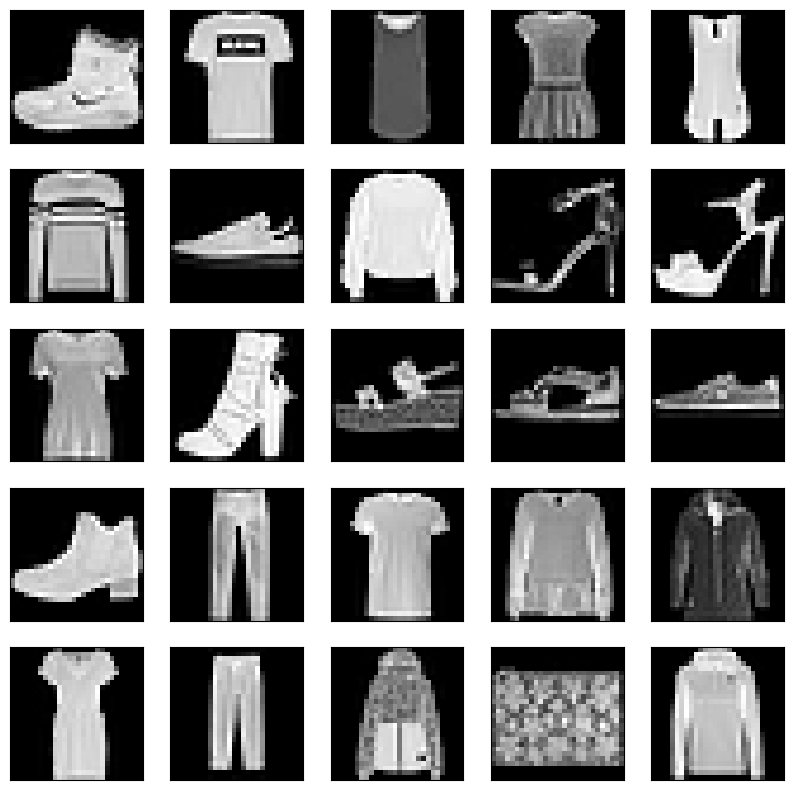

In [ ]:
plt.figure(figsize=(10,10))
for i in range(25):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(x_train[i], cmap='gray')
plt.show()

##  Basic Autoencoder

Define an autoencoder with two Dense layers: an `encoder`, which compresses the images into a `latent_dim` dimensional latent vector, and a `decoder`, that reconstructs the original image from the latent space.

To define your model, use the [Keras Model Subclassing API](https://www.tensorflow.org/guide/keras/custom_layers_and_models).


In [ ]:
model = keras.Sequential()
model.add(tf.keras.Sequential([
            layers.Flatten(),
            layers.Dense(self.latent_dim, activation='relu'),
        ]))
model.add(tf.keras.Sequential([
            layers.Dense(28*28, activation='sigmoid'),
            layers.Reshape((28, 28))
        ]))

model.summary()

In [ ]:
class Autoencoder(tf.keras.Model):
    def __init__(self, latent_dim):
        super(Autoencoder, self).__init__()
        self.latent_dim = latent_dim
        self.encoder = tf.keras.Sequential([
            layers.Flatten(),
            layers.Dense(self.latent_dim, activation='relu'),
        ])
        self.decoder = tf.keras.Sequential([
            layers.Dense(28*28, activation='sigmoid'),
            layers.Reshape((28, 28))
        ])


    def call(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return decoded

latent_dim = 64
autoencoder = Autoencoder(latent_dim)

In [ ]:
class Encoder(layers.Layer):
    def __init__(self, latent_dim=32, name="encoder", **kwargs):
        super(Encoder, self).__init__(name=name, **kwargs)
        self.latent_dim = latent_dim
        self.dense = layers.Dense(self.latent_dim, activation='relu')

    def call(self, inputs):
        x = layers.Flatten()(inputs)
        x = self.dense(x)
        return x


class Decoder(layers.Layer):
    """Converts z, the encoded digit vector, back into a readable digit."""

    def __init__(self, original_dim, name="decoder", **kwargs):
        super(Decoder, self).__init__(name=name, **kwargs)
        self.original_dim = original_dim
        self.dense = layers.Dense(self.original_dim, activation='relu')

    def call(self, inputs):
        x = self.dense(inputs)
        x = layers.Reshape((28, 28))(x)
        return x


class AutoEncoder2(tf.keras.Model):
    """Combines the encoder and decoder into an end-to-end model for training."""

    def __init__(
        self,
        original_dim,
        latent_dim,
        name="autoencoder",
        **kwargs
    ):
        super(AutoEncoder2, self).__init__(name=name, **kwargs)
        self.latent_dim = latent_dim
        self.original_dim = original_dim
        self.encoder = Encoder(latent_dim=latent_dim)
        self.decoder = Decoder(original_dim=original_dim)

    def call(self, inputs):
        x = self.encoder(inputs)
        x = self.decoder(x)
        return x

autoencoder2 = AutoEncoder2(original_dim=28*28, latent_dim=latent_dim)

In [ ]:
def get_autoencoder(latent_dim, input_shape=(28, 28)):
    inputs = tf.keras.Input(shape=input_shape, name='input')
    # encoder
    encoded = layers.Flatten()(inputs)
    encoded = layers.Dense(latent_dim, activation='relu')(encoded)
    # decoder
    decoded = layers.Dense(np.prod(input_shape), activation='sigmoid')(encoded)
    decoded = layers.Reshape((28, 28))(decoded)

    # model
    autoencoder = tf.keras.Model(inputs=inputs, outputs=decoded)
    autoencoder.compile(optimizer='adam', loss='mse')
    return autoencoder


autoencoder = get_autoencoder(latent_dim, input_shape=(28, 28))

Train the model using `x_train` as both the input and the target. The `encoder` will learn to compress the dataset from `latent_dim` dimensions to the latent space, and the `decoder` will learn to reconstruct the original images.
.

In [ ]:
autoencoder.fit(x_train, x_train,
                epochs=10,
                batch_size=64,
                validation_data=(x_test, x_test))

Epoch 1/10
938/938 [==============================] - 9s 4ms/step - loss: 0.0300 - val_loss: 0.0164
Epoch 2/10
938/938 [==============================] - 3s 3ms/step - loss: 0.0135 - val_loss: 0.0119
Epoch 3/10
938/938 [==============================] - 3s 3ms/step - loss: 0.0112 - val_loss: 0.0106
Epoch 4/10
938/938 [==============================] - 3s 3ms/step - loss: 0.0102 - val_loss: 0.0099
Epoch 5/10
938/938 [==============================] - 3s 4ms/step - loss: 0.0096 - val_loss: 0.0095
Epoch 6/10
938/938 [==============================] - 3s 3ms/step - loss: 0.0093 - val_loss: 0.0093
Epoch 7/10
938/938 [==============================] - 3s 3ms/step - loss: 0.0091 - val_loss: 0.0092
Epoch 8/10
938/938 [==============================] - 3s 3ms/step - loss: 0.0090 - val_loss: 0.0091
Epoch 9/10
938/938 [==============================] - 3s 4ms/step - loss: 0.0089 - val_loss: 0.0090
Epoch 10/10
938/938 [==============================] - 3s 3ms/step - loss: 0.0089 - val_loss: 0.0089

Compute the `test_mse`

In [ ]:
test_mse = autoencoder.evaluate(x_test, x_test)
print('MSE Test:', test_mse)

313/313 [==============================] - 1s 2ms/step - loss: 0.0089
MSE Test: 0.008901956491172314


Now that the model is trained, let's test it by encoding and decoding images from the test set.

In [ ]:
decoded_imgs = autoencoder(x_test).numpy()

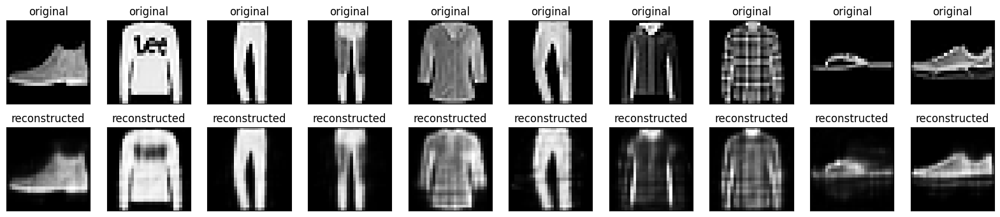

In [ ]:
n = 10
plt.figure(figsize=(20, 4))
for i in range(n):
    # display original
    ax = plt.subplot(2, n, i + 1)
    plt.imshow(x_test[i])
    plt.title("original")
    plt.gray()
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)

    # display reconstruction
    ax = plt.subplot(2, n, i + 1 + n)
    plt.imshow(decoded_imgs[i])
    plt.title("reconstructed")
    plt.gray()
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()

Lets try different dimensions

####################################################################################################
Latent dimension: 16, MSE Test: 0.0177016444504261, elapsed time: 18.605076789855957


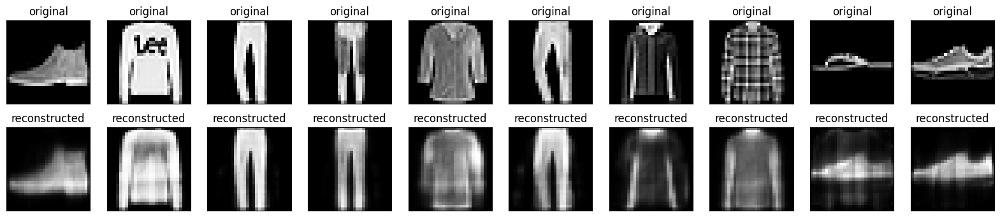

####################################################################################################
Latent dimension: 32, MSE Test: 0.012970474548637867, elapsed time: 22.821441173553467


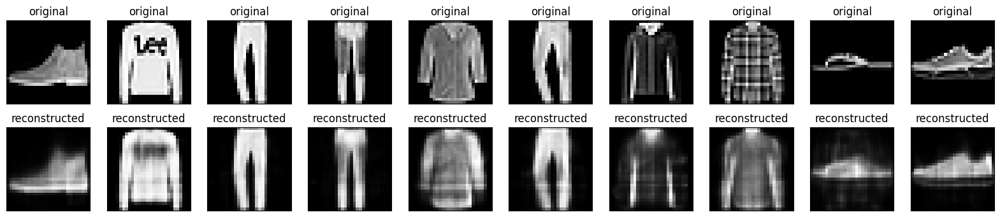

####################################################################################################
Latent dimension: 64, MSE Test: 0.009193599224090576, elapsed time: 18.947750329971313


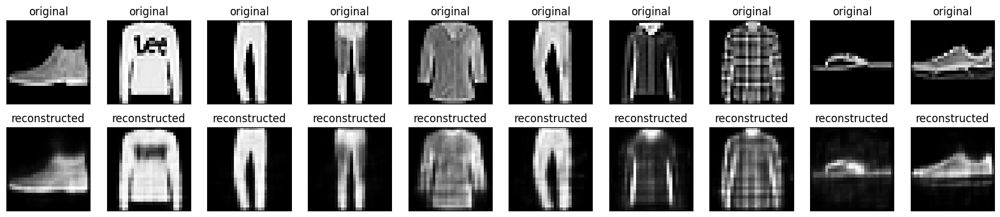

####################################################################################################
Latent dimension: 128, MSE Test: 0.006141699850559235, elapsed time: 22.7140154838562


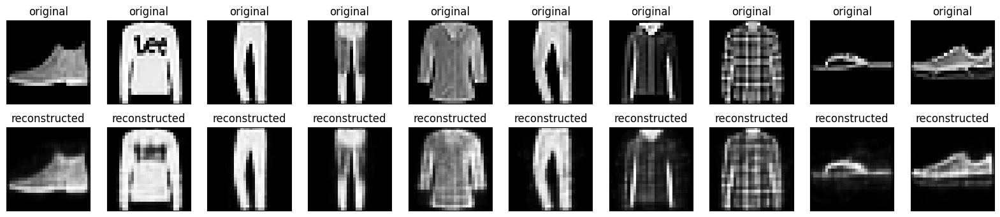

####################################################################################################
Latent dimension: 256, MSE Test: 0.0038453852757811546, elapsed time: 18.74951934814453


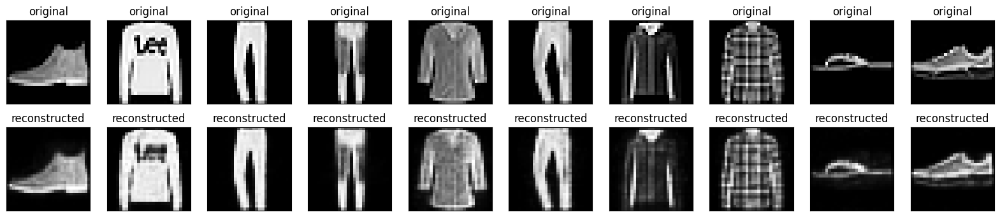

####################################################################################################
Latent dimension: 512, MSE Test: 0.002463129349052906, elapsed time: 23.535008668899536


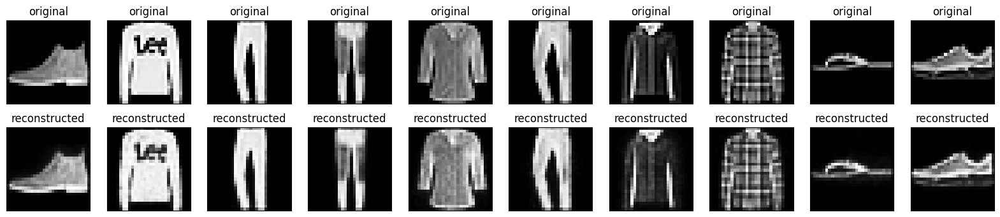

####################################################################################################
Latent dimension: 784, MSE Test: 0.0017199493013322353, elapsed time: 18.57440495491028


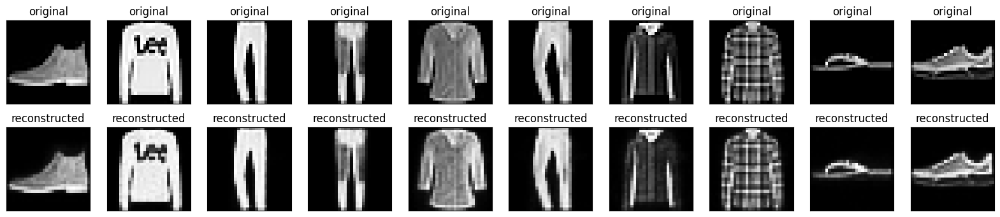

In [ ]:
for latent_dim in [16, 32, 64, 128, 256, 512, 784]:
    t = time.time()
    autoencoder = get_autoencoder(latent_dim, input_shape=(28, 28))
    autoencoder.fit(x_train, x_train, epochs=7, batch_size=64, verbose=0)
    test_mse = autoencoder.evaluate(x_test, x_test, verbose=0)
    elapsed_time = time.time() - t
    print('#' * 100)
    print('Latent dimension: {0}, MSE Test: {1}, elapsed time: {2}'.format(
        latent_dim, test_mse, elapsed_time))
    n = 10
    reconstructed = autoencoder(x_test).numpy()
    plt.figure(figsize=(20, 4))
    for i in range(n):
        # display original
        ax = plt.subplot(2, n, i + 1)
        plt.imshow(x_test[i])
        plt.title("original")
        plt.gray()
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # display reconstruction
        ax = plt.subplot(2, n, i + 1 + n)
        plt.imshow(reconstructed[i])
        plt.title("reconstructed")
        plt.gray()
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
    plt.show()

We can add more complexity to the model

In [ ]:
latent_dim = 64

def get_autoencoder(latent_dim, input_shape=(28, 28)):
    inputs = tf.keras.Input(shape=input_shape, name='input')
    # encoder
    encoded = layers.Flatten()(inputs)
    encoded = layers.Dense(2 * latent_dim, activation='relu')(encoded)
    encoded = layers.Dense(latent_dim, activation='relu')(encoded)
    # decoder
    decoded = layers.Dense(2 * latent_dim, activation='relu')(encoded)
    decoded = layers.Dense(np.prod(input_shape), activation='sigmoid')(encoded)
    decoded = layers.Reshape((28, 28))(decoded)

    # model
    autoencoder = tf.keras.Model(inputs=inputs, outputs=decoded)
    autoencoder.compile(optimizer='adam', loss='mse')
    return autoencoder

latent_dim = 128
autoencoder = get_autoencoder(latent_dim, input_shape=(28, 28))

In [ ]:
autoencoder.fit(x_train, x_train,
                epochs=10,
                batch_size=64,
                validation_data=(x_test, x_test))

Epoch 1/10
938/938 [==============================] - 5s 4ms/step - loss: 0.0239 - val_loss: 0.0136
Epoch 2/10
938/938 [==============================] - 3s 4ms/step - loss: 0.0118 - val_loss: 0.0104
Epoch 3/10
938/938 [==============================] - 3s 4ms/step - loss: 0.0096 - val_loss: 0.0091
Epoch 4/10
938/938 [==============================] - 3s 4ms/step - loss: 0.0084 - val_loss: 0.0079
Epoch 5/10
938/938 [==============================] - 3s 3ms/step - loss: 0.0076 - val_loss: 0.0078
Epoch 6/10
938/938 [==============================] - 3s 3ms/step - loss: 0.0071 - val_loss: 0.0070
Epoch 7/10
938/938 [==============================] - 4s 4ms/step - loss: 0.0067 - val_loss: 0.0068
Epoch 8/10
938/938 [==============================] - 4s 4ms/step - loss: 0.0064 - val_loss: 0.0064
Epoch 9/10
938/938 [==============================] - 3s 4ms/step - loss: 0.0061 - val_loss: 0.0062
Epoch 10/10
938/938 [==============================] - 4s 4ms/step - loss: 0.0060 - val_loss: 0.0060

In [ ]:
test_mse = autoencoder.evaluate(x_test, x_test)
print('MSE Test:', test_mse)

313/313 [==============================] - 1s 2ms/step - loss: 0.0060
MSE Test: 0.006016947794705629


In [ ]:
decoded_imgs = autoencoder(x_test).numpy()

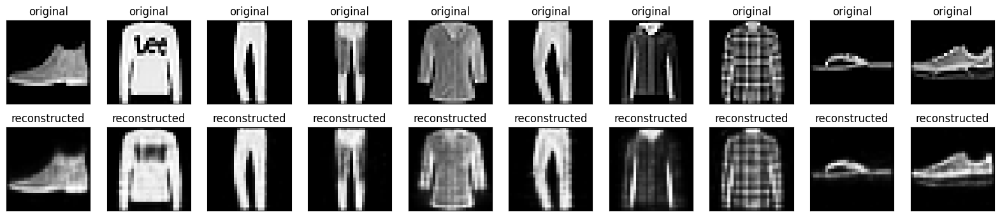

In [ ]:
n = 10
plt.figure(figsize=(20, 4))
for i in range(n):
    # display original
    ax = plt.subplot(2, n, i + 1)
    plt.imshow(x_test[i])
    plt.title("original")
    plt.gray()
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)

    # display reconstruction
    ax = plt.subplot(2, n, i + 1 + n)
    plt.imshow(decoded_imgs[i])
    plt.title("reconstructed")
    plt.gray()
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()

###  Convolutional autoencoder

We will use Conv2D layer for the encoder and [Transposed convolution layer](https://www.tensorflow.org/api_docs/python/tf/keras/layers/Conv2DTranspose) (sometimes called Deconvolution) for the decoder

```python
tf.keras.layers.Conv2DTranspose(
    filters, kernel_size, strides=(1, 1)
```

- **Input shape**: (batch_size, rows, cols, channels)

- **Output shape**: (batch_size, new_rows, new_cols, filters)
    - new_rows = ((rows - 1) * strides[0] + kernel_size[0] - 2 * padding[0] +output_padding[0])
    - new_cols = ((cols - 1) * strides[1] + kernel_size[1] - 2 * padding[1] +output_padding[1])

In [ ]:
x = tf.random.normal((4, 28, 28, 1))
print('x shape: ', x.shape)
x1 = tf.keras.layers.Conv2D(6, (3,3), padding='same')(x)
print('x1 shape: ', x1.shape)
x2 = tf.keras.layers.Conv2DTranspose(1, (3,3), padding='same')(x1)
print('x2 shape: ', x2.shape)
print('x2 shape padding valid: ', tf.keras.layers.Conv2DTranspose(1, (3,3), padding='valid')(x1).shape)

x shape:  (4, 28, 28, 1)
x1 shape:  (4, 28, 28, 6)
x2 shape:  (4, 28, 28, 1)
x2 shape padding valid:  (4, 30, 30, 1)


In [ ]:

def get_conv_autoencoder(input_shape=(28, 28, 1)):
    inputs = tf.keras.Input(shape=input_shape, name='input')
    # encoder
    encoded = layers.Conv2D(16, (3,3), strides=(2,2),activation='relu', padding='same')(inputs)
    encoded = layers.Conv2D(16, (3,3), strides=(2,2), activation='relu', padding='same')(encoded)
    # decoder
    decoded = layers.Conv2DTranspose(16, kernel_size=3, strides=(2,2), activation='relu', padding='same')(encoded)
    decoded = layers.Conv2DTranspose(16, kernel_size=3, strides=(2,2), activation='relu', padding='same')(decoded)
    decoded = layers.Conv2DTranspose(1, kernel_size=(3,3), activation='sigmoid', padding='same')(decoded)

    # model
    autoencoder = tf.keras.Model(inputs=inputs, outputs=decoded)
    autoencoder.compile(optimizer='adam', loss='mse')
    return autoencoder

autoencoder = get_conv_autoencoder(input_shape=(28, 28, 1))
autoencoder.summary()

Model: "model_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input (InputLayer)          [(None, 28, 28, 1)]       0         
                                                                 
 conv2d_1 (Conv2D)           (None, 14, 14, 16)        160       
                                                                 
 conv2d_2 (Conv2D)           (None, 7, 7, 16)          2320      
                                                                 
 conv2d_transpose_2 (Conv2D  (None, 14, 14, 16)        2320      
 Transpose)                                                      
                                                                 
 conv2d_transpose_3 (Conv2D  (None, 28, 28, 16)        2320      
 Transpose)                                                      
                                                                 
 conv2d_transpose_4 (Conv2D  (None, 28, 28, 1)         145 

In [ ]:
(x_train, _), (x_test, _) = fashion_mnist.load_data()

x_train = x_train.astype('float32') / 255.
x_test = x_test.astype('float32') / 255.

x_train = np.expand_dims(x_train, -1)
x_test = np.expand_dims(x_test, -1)

print(x_train.shape)

(60000, 28, 28, 1)


In [ ]:
autoencoder.fit(x_train, x_train,
                epochs=10,
                batch_size=64,
                validation_data=(x_test, x_test))

Epoch 1/10
938/938 [==============================] - 7s 6ms/step - loss: 0.0152 - val_loss: 0.0054
Epoch 2/10
938/938 [==============================] - 5s 5ms/step - loss: 0.0041 - val_loss: 0.0033
Epoch 3/10
938/938 [==============================] - 5s 5ms/step - loss: 0.0029 - val_loss: 0.0025
Epoch 4/10
938/938 [==============================] - 4s 5ms/step - loss: 0.0023 - val_loss: 0.0021
Epoch 5/10
938/938 [==============================] - 5s 5ms/step - loss: 0.0019 - val_loss: 0.0018
Epoch 6/10
938/938 [==============================] - 5s 5ms/step - loss: 0.0016 - val_loss: 0.0015
Epoch 7/10
938/938 [==============================] - 5s 5ms/step - loss: 0.0014 - val_loss: 0.0013
Epoch 8/10
938/938 [==============================] - 5s 5ms/step - loss: 0.0013 - val_loss: 0.0013
Epoch 9/10
938/938 [==============================] - 5s 5ms/step - loss: 0.0012 - val_loss: 0.0011
Epoch 10/10
938/938 [==============================] - 5s 5ms/step - loss: 0.0011 - val_loss: 0.0010

In [ ]:
test_mse = autoencoder.evaluate(x_test, x_test)
print('MSE Test:', test_mse)

313/313 [==============================] - 1s 3ms/step - loss: 0.0010
MSE Test: 0.0010086894035339355


In [ ]:
decoded_imgs = autoencoder(x_test).numpy()

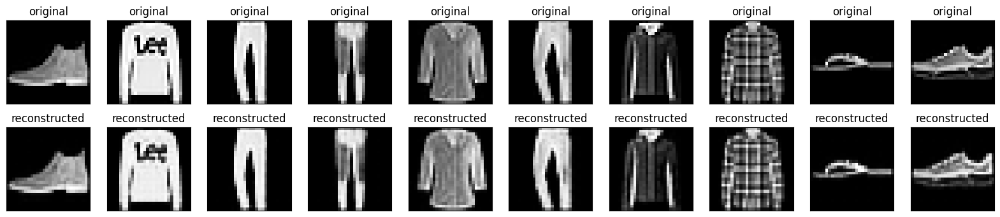

In [ ]:
n = 10
plt.figure(figsize=(20, 4))
for i in range(n):
    # display original
    ax = plt.subplot(2, n, i + 1)
    plt.imshow(x_test[i])
    plt.title("original")
    plt.gray()
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)

    # display reconstruction
    ax = plt.subplot(2, n, i + 1 + n)
    plt.imshow(decoded_imgs[i])
    plt.title("reconstructed")
    plt.gray()
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()

## Image denoising



An autoencoder can also be trained to remove noise from images. In the following section, you will create a noisy version of the Fashion MNIST dataset by applying random noise to each image. You will then train an autoencoder using the noisy image as input, and the original image as the target.

Let's reimport the dataset to omit the modifications made earlier.

Adding random noise to the images

In [ ]:
sigma = 0.3
x_train_noisy = x_train + sigma * tf.random.normal(shape=x_train.shape)
x_test_noisy = x_test + sigma * tf.random.normal(shape=x_test.shape)

x_train_noisy = tf.clip_by_value(x_train_noisy, clip_value_min=0., clip_value_max=1.)
x_test_noisy = tf.clip_by_value(x_test_noisy, clip_value_min=0., clip_value_max=1.)

Plot the noisy images.


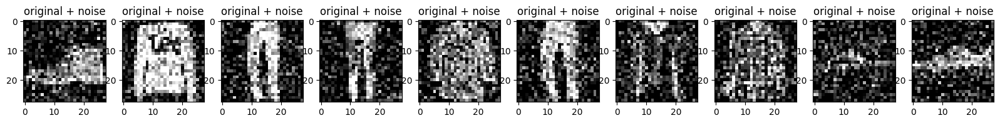

In [ ]:
n = 10
plt.figure(figsize=(20, 2))
for i in range(n):
    ax = plt.subplot(1, n, i + 1)
    plt.title("original + noise")
    plt.imshow(tf.squeeze(x_test_noisy[i]))
    plt.gray()
plt.show()

In [ ]:
autoencoder = get_conv_autoencoder(input_shape=(28, 28, 1))

In [ ]:
autoencoder.fit(x_train_noisy, x_train,
                epochs=10,
                shuffle=True,
                validation_data=(x_test_noisy, x_test))

Epoch 1/10
1875/1875 [==============================] - 10s 4ms/step - loss: 0.0176 - val_loss: 0.0119
Epoch 2/10
1875/1875 [==============================] - 8s 4ms/step - loss: 0.0112 - val_loss: 0.0109
Epoch 3/10
1875/1875 [==============================] - 8s 4ms/step - loss: 0.0106 - val_loss: 0.0104
Epoch 4/10
1875/1875 [==============================] - 8s 4ms/step - loss: 0.0102 - val_loss: 0.0101
Epoch 5/10
1875/1875 [==============================] - 9s 5ms/step - loss: 0.0100 - val_loss: 0.0099
Epoch 6/10
1875/1875 [==============================] - 9s 5ms/step - loss: 0.0098 - val_loss: 0.0098
Epoch 7/10
1875/1875 [==============================] - 8s 4ms/step - loss: 0.0097 - val_loss: 0.0097
Epoch 8/10
1875/1875 [==============================] - 8s 4ms/step - loss: 0.0096 - val_loss: 0.0096
Epoch 9/10
1875/1875 [==============================] - 8s 4ms/step - loss: 0.0095 - val_loss: 0.0097
Epoch 10/10
1875/1875 [==============================] - 8s 4ms/step - loss: 0.00

In [ ]:
test_mse = autoencoder.evaluate(x_test, x_test)
print('MSE Test:', test_mse)

313/313 [==============================] - 1s 2ms/step - loss: 0.0070
MSE Test: 0.00697153527289629


In [ ]:
decoded_imgs = autoencoder(x_test).numpy()

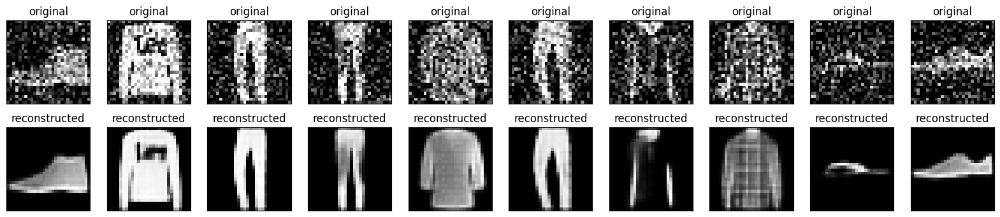

In [ ]:
n = 10
plt.figure(figsize=(20, 4))
for i in range(n):
    # display original
    ax = plt.subplot(2, n, i + 1)
    plt.imshow(x_test_noisy[i])
    plt.title("original")
    plt.gray()
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)

    # display reconstruction
    ax = plt.subplot(2, n, i + 1 + n)
    plt.imshow(decoded_imgs[i])
    plt.title("reconstructed")
    plt.gray()
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()

We can change the noise during training.

In [ ]:
autoencoder = get_conv_autoencoder(input_shape=(28, 28, 1))

###########################################################################
epoch : 0
1875/1875 [==============================] - 9s 4ms/step - loss: 0.0181 - val_loss: 0.0122


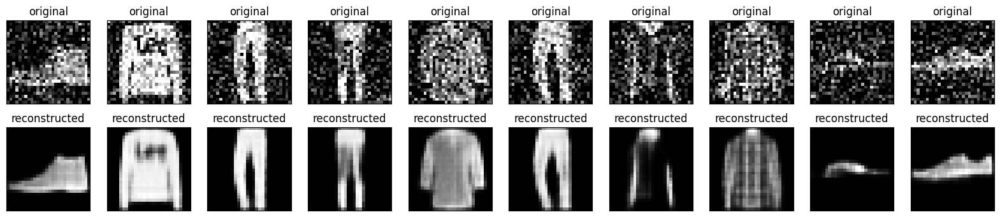

###########################################################################
epoch : 1
1875/1875 [==============================] - 8s 4ms/step - loss: 0.0115 - val_loss: 0.0111


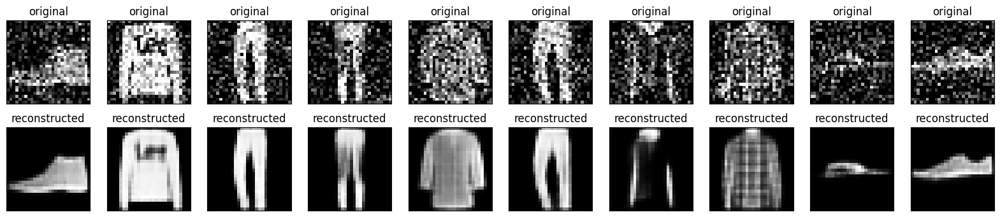

###########################################################################
epoch : 2
1875/1875 [==============================] - 8s 4ms/step - loss: 0.0107 - val_loss: 0.0106


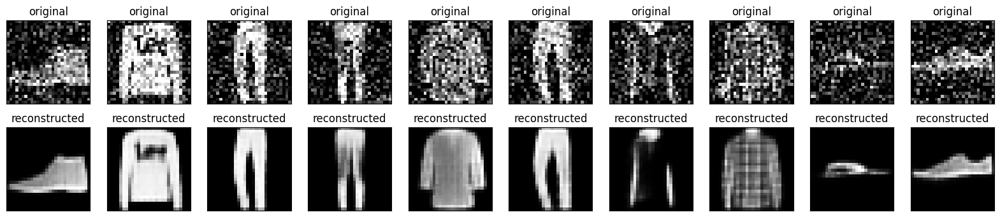

###########################################################################
epoch : 3
1875/1875 [==============================] - 8s 4ms/step - loss: 0.0103 - val_loss: 0.0102


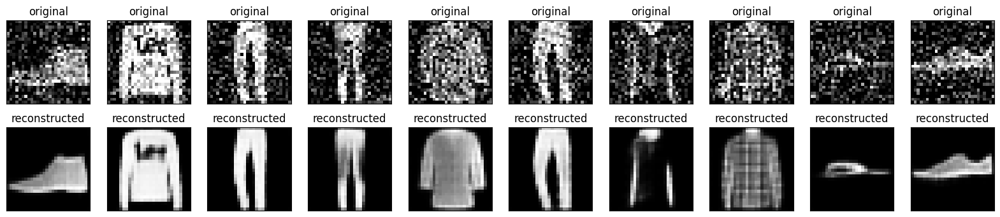

###########################################################################
epoch : 4
1875/1875 [==============================] - 8s 4ms/step - loss: 0.0101 - val_loss: 0.0101


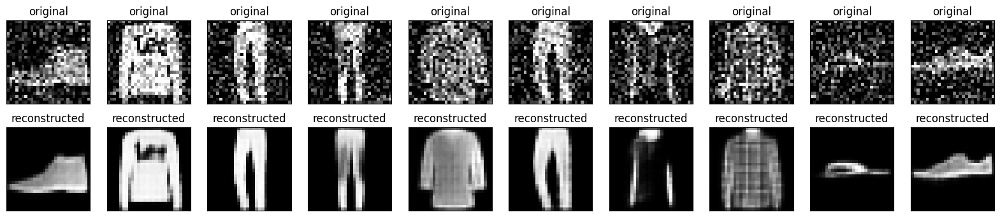

In [ ]:
for epoch in range(5):
    print('#'*75)
    print('epoch :', epoch)
    x_train_noisy = x_train + sigma * tf.random.normal(shape=x_train.shape)
    x_train_noisy = tf.clip_by_value(x_train_noisy, clip_value_min=0., clip_value_max=1.)
    autoencoder.fit(x_train_noisy, x_train,
                epochs=1,
                shuffle=True,
                validation_data=(x_test_noisy, x_test))

    decoded_imgs = autoencoder(x_test).numpy()
    n = 10
    plt.figure(figsize=(20, 4))
    for i in range(n):
        # display original
        ax = plt.subplot(2, n, i + 1)
        plt.imshow(x_test_noisy[i])
        plt.title("original")
        plt.gray()
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # display reconstruction
        ax = plt.subplot(2, n, i + 1 + n)
        plt.imshow(decoded_imgs[i])
        plt.title("reconstructed")
        plt.gray()
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
    plt.show()


## Practice: Create a denoising autoencoder for the flower's dataset  

In [ ]:
import pathlib
import tensorflow as tf
dataset_url = 'https://storage.googleapis.com/download.tensorflow.org/example_images/flower_photos.tgz'
data_dir = tf.keras.utils.get_file('flower_photos', origin=dataset_url, untar=True)
data_dir = pathlib.Path(data_dir)

228813984/228813984 [==============================] - 1s 0us/step


In [ ]:
image_size = (128,128)
train_ds = tf.keras.preprocessing.image_dataset_from_directory(
  data_dir,
  validation_split=0.2,  # 80%  train, 20% validation
  subset='training',  # 'training' o 'validation', only  with 'validation_split'
  seed=1,
  image_size=image_size,  # Dimension (img_height, img_width) for rescaling
  batch_size=64
)

val_ds = tf.keras.preprocessing.image_dataset_from_directory(
  data_dir,
  validation_split=0.2,
  subset='validation',
  seed=1,
  image_size=image_size,
  batch_size=64)

Found 3670 files belonging to 5 classes.
Using 2936 files for training.
Found 3670 files belonging to 5 classes.
Using 734 files for validation.


In [ ]:
def prepare_dataset(x_in, sigma=0.2):
    x = x_in / 255
    x_noisy = x + sigma * tf.random.normal(shape=tf.shape(x))
    x_noisy = tf.clip_by_value(x_noisy, clip_value_min=0., clip_value_max=1.)
    return (x_noisy, x)


train_ds = train_ds.map(lambda x, y: prepare_dataset(x))
val_ds = val_ds.map(lambda x, y: prepare_dataset(x))

AUTOTUNE = tf.data.AUTOTUNE

train_ds = train_ds.cache().shuffle(1000).prefetch(buffer_size=AUTOTUNE)
val_ds = val_ds.cache().prefetch(buffer_size=AUTOTUNE)

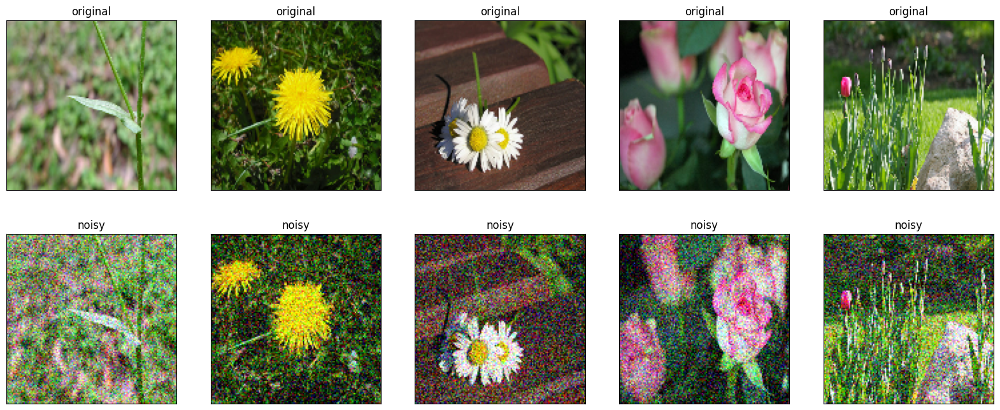

In [ ]:
for x_noisy, x in val_ds.take(1):
    n = 5
    plt.figure(figsize=(20, 8))
    for i in range(n):
        # display original
        ax = plt.subplot(2, n, i + 1)
        plt.imshow(x[i])
        plt.title("original")
        plt.gray()
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # display reconstruction
        ax = plt.subplot(2, n, i + 1 + n)
        plt.imshow(x_noisy[i])
        plt.title("noisy")
        plt.gray()
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

In [ ]:
def get_conv_autoencoder(input_shape=(28, 28, 1)):
    inputs = tf.keras.Input(shape=input_shape, name='input')
    # encoder
    encoded = layers.Conv2D(64, (3,3), strides=(2,2),activation='relu', padding='same')(inputs)
    encoded = layers.BatchNormalization()(encoded)
    encoded = layers.Conv2D(32, (3,3), strides=(2,2), activation='relu', padding='same')(encoded)

    # decoder
    decoded = layers.Conv2DTranspose(32, kernel_size=3, strides=(2,2), activation='relu', padding='same')(encoded)
    decoded = layers.BatchNormalization()(decoded)
    decoded = layers.Conv2DTranspose(64, kernel_size=3, strides=(2,2), activation='relu', padding='same')(decoded)
    decoded = layers.Conv2DTranspose(3, kernel_size=(3,3), activation='sigmoid', padding='same')(decoded)

    # model
    autoencoder = tf.keras.Model(inputs=inputs, outputs=decoded)
    autoencoder.compile(optimizer='adam', loss='mse')
    return autoencoder

autoencoder = get_conv_autoencoder(input_shape=(128,128,3))
autoencoder.summary()

Model: "model_16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input (InputLayer)          [(None, 128, 128, 3)]     0         
                                                                 
 conv2d_15 (Conv2D)          (None, 64, 64, 64)        1792      
                                                                 
 batch_normalization_2 (Bat  (None, 64, 64, 64)        256       
 chNormalization)                                                
                                                                 
 conv2d_16 (Conv2D)          (None, 32, 32, 32)        18464     
                                                                 
 conv2d_transpose_23 (Conv2  (None, 64, 64, 32)        9248      
 DTranspose)                                                     
                                                                 
 batch_normalization_3 (Bat  (None, 64, 64, 32)        128

############################################################
epoch 0
46/46 [==============================] - 9s 152ms/step - loss: 0.0271 - val_loss: 0.0783


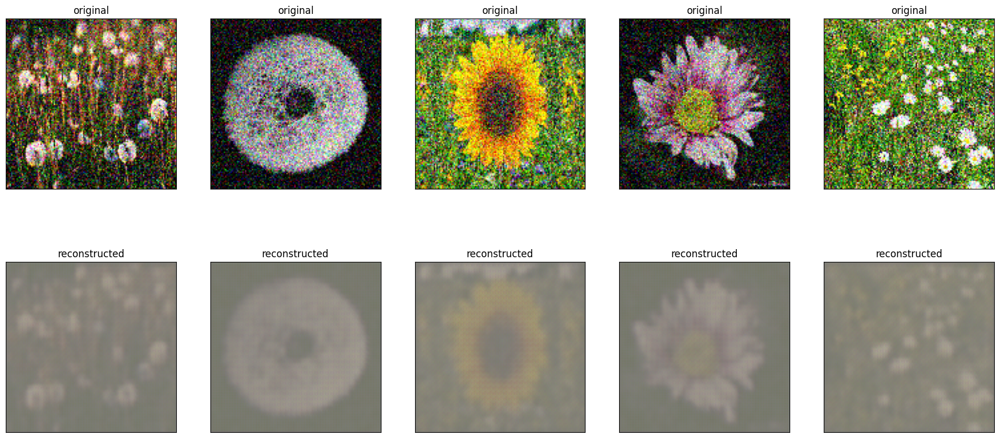

############################################################
epoch 1
46/46 [==============================] - 5s 116ms/step - loss: 0.0105 - val_loss: 0.0642


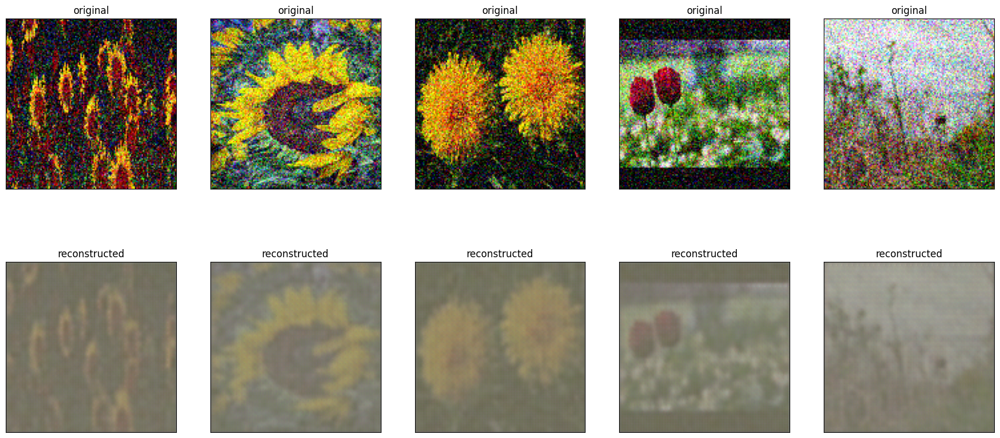

############################################################
epoch 2
46/46 [==============================] - 5s 117ms/step - loss: 0.0090 - val_loss: 0.0546


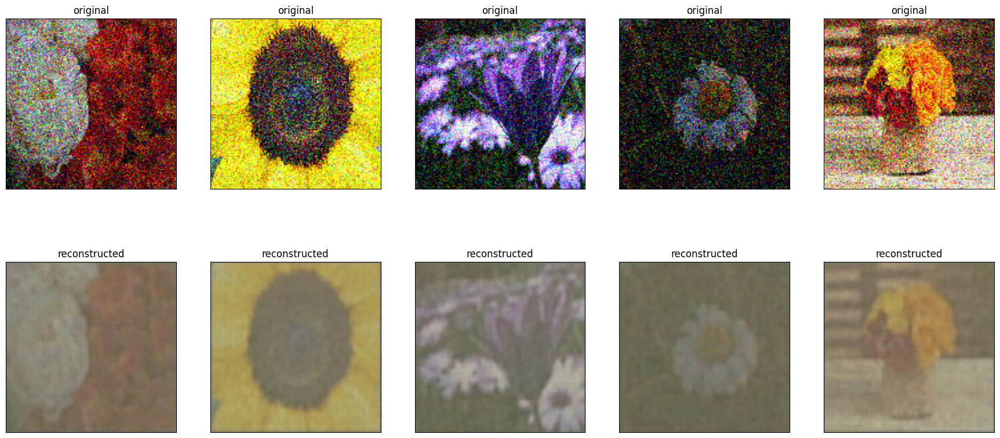

############################################################
epoch 3
46/46 [==============================] - 6s 139ms/step - loss: 0.0083 - val_loss: 0.0409


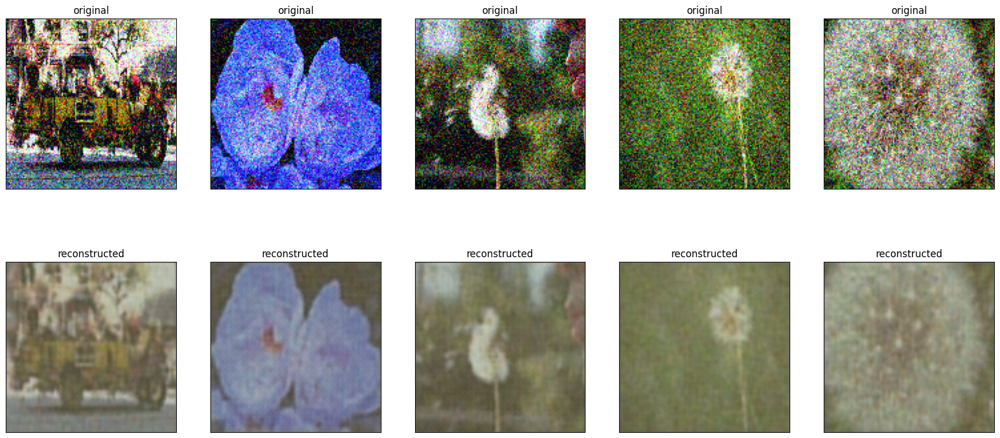

############################################################
epoch 4
46/46 [==============================] - 6s 141ms/step - loss: 0.0079 - val_loss: 0.0300


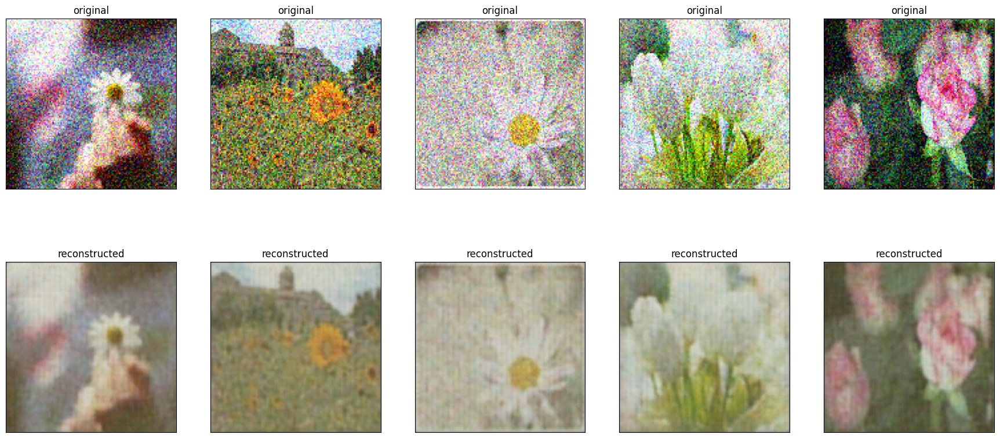

############################################################
epoch 5
46/46 [==============================] - 6s 138ms/step - loss: 0.0075 - val_loss: 0.0212


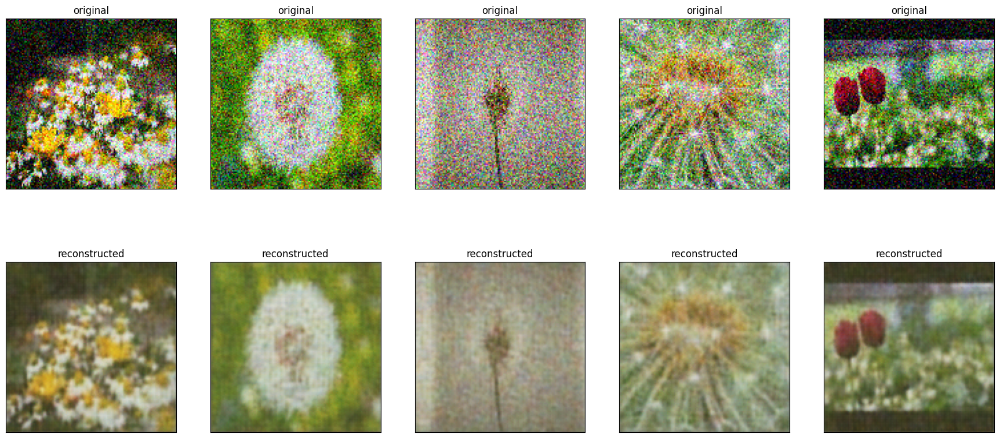

############################################################
epoch 6
46/46 [==============================] - 6s 138ms/step - loss: 0.0073 - val_loss: 0.0145


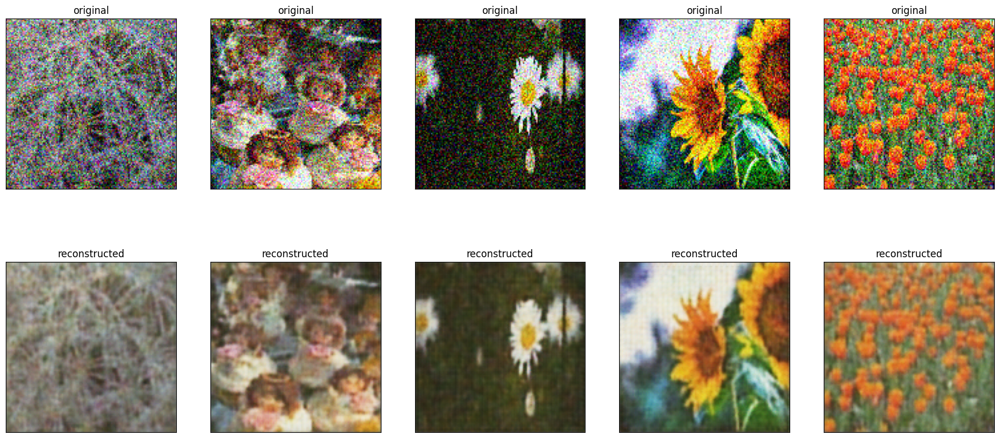

############################################################
epoch 7
46/46 [==============================] - 6s 136ms/step - loss: 0.0071 - val_loss: 0.0117


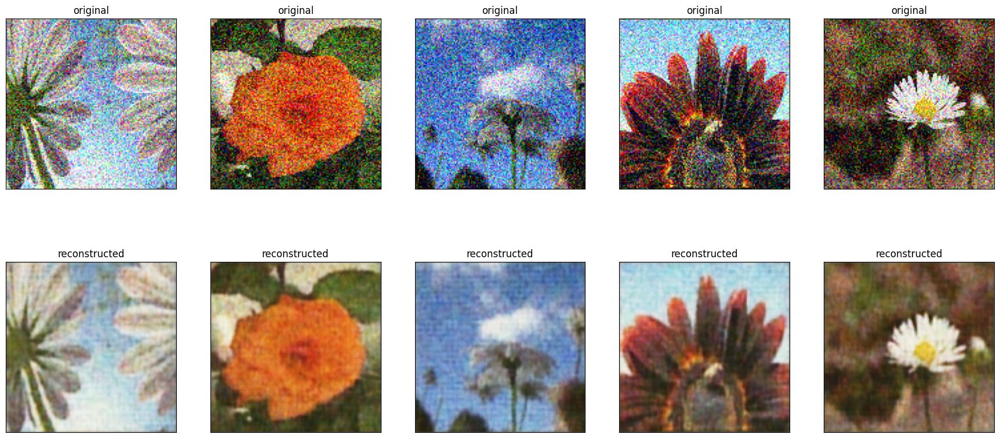

############################################################
epoch 8
46/46 [==============================] - 6s 135ms/step - loss: 0.0070 - val_loss: 0.0089


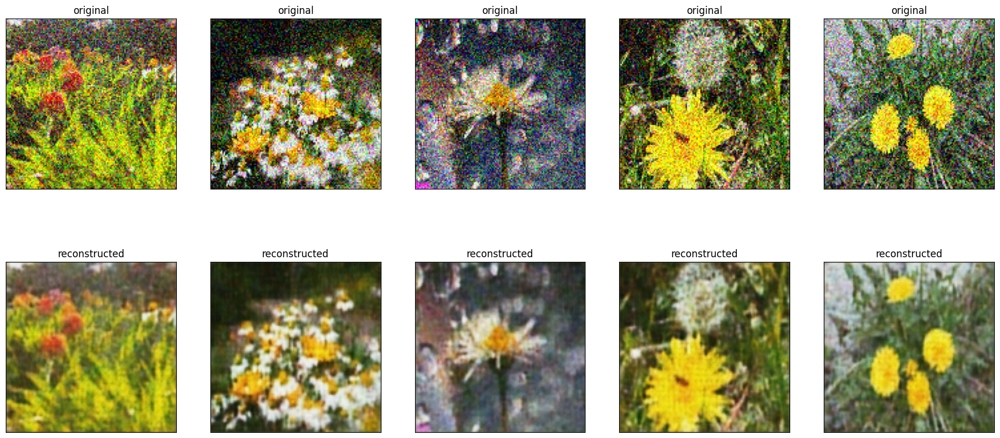

############################################################
epoch 9
46/46 [==============================] - 6s 136ms/step - loss: 0.0069 - val_loss: 0.0092


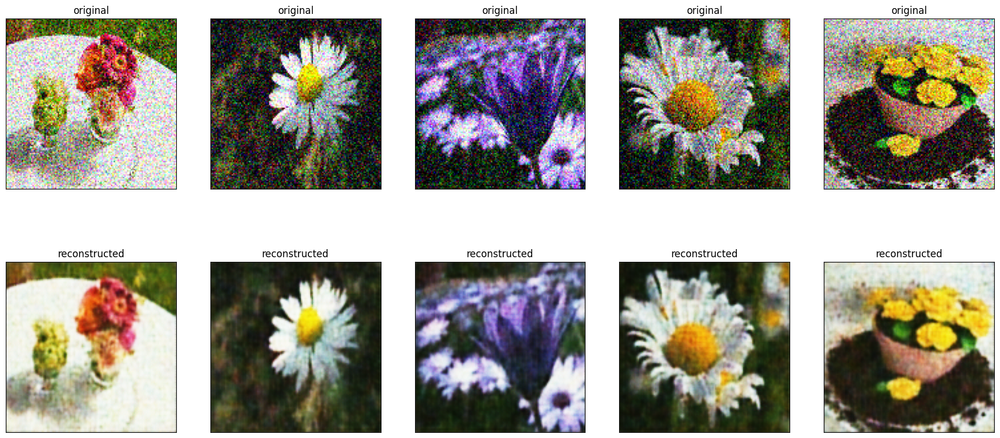

In [ ]:
for epoch in range(10):
    print('#' * 60)
    print('epoch', epoch)
    autoencoder.fit(train_ds,
                    epochs=1,
                    validation_data=val_ds,
                    validation_steps=10)
    for x_noisy, x in val_ds.take(1):
        decoded_imgs = autoencoder(x_noisy).numpy()
        n = 5
        plt.figure(figsize=(22, 10))
        for i in range(n):
            # display original
            ax = plt.subplot(2, n, i + 1)
            plt.imshow(x_noisy[i])
            plt.title("original")
            plt.gray()
            ax.get_xaxis().set_visible(False)
            ax.get_yaxis().set_visible(False)

            # display reconstruction
            ax = plt.subplot(2, n, i + 1 + n)
            plt.imshow(decoded_imgs[i])
            plt.title("reconstructed")
            plt.gray()
            ax.get_xaxis().set_visible(False)
            ax.get_yaxis().set_visible(False)
        plt.show()

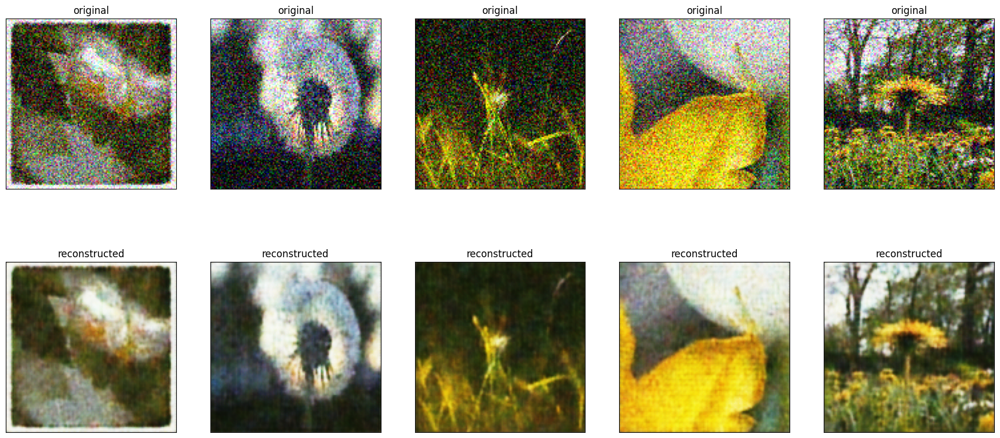

In [ ]:
for x_noisy, x in val_ds.take(1):
    decoded_imgs = autoencoder(x_noisy).numpy()
    n = 5
    plt.figure(figsize=(22, 10))
    for i in range(n):
        # display original
        ax = plt.subplot(2, n, i + 1)
        plt.imshow(x_noisy[i])
        plt.title("original")
        plt.gray()
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # display reconstruction
        ax = plt.subplot(2, n, i + 1 + n)
        plt.imshow(decoded_imgs[i])
        plt.title("reconstructed")
        plt.gray()
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)